<a href="https://colab.research.google.com/github/ImSouritra/Deep-Learning-and-Neural-Networks/blob/master/Deep-Learning-and-Neural-Networks/Food%20Vision%20Small/Transfer_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Transfer Learning with Tensorflow: Feature Extraction

Transfer learning is leveraging a working model's architecture and learned patterns for our own model.

There are two main benefits:
1. Can leverage an existing neural network architecture proven to work on similar problem.
2. Can leverage a working neural network architecture similar data to our own.


In [1]:
import os
import pathlib
import datetime
import zipfile
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import image_dataset_from_directory

In [ ]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip
file_ref = zipfile.ZipFile("10_food_classes_10_percent.zip")
file_ref.extractall()
file_ref.close()

--2022-09-18 05:42:48--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.141.128, 173.194.210.128, 173.194.212.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.141.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 168546183 (161M) [application/zip]
Saving to: ‘10_food_classes_10_percent.zip’

10_food_classes_10_ 100%[===================>] 160.74M   121MB/s    in 1.3s    

2022-09-18 05:42:50 (121 MB/s) - ‘10_food_classes_10_percent.zip’ saved [168546183/168546183]



In [ ]:
for dir_path, dir_name , filename in os.walk("/content/10_food_classes_10_percent"):
  print(f"There are {len(dir_path)} directories and {len(filename)} images in {dir_path}")

There are 35 directories and 0 images in /content/10_food_classes_10_percent
There are 41 directories and 0 images in /content/10_food_classes_10_percent/train
There are 56 directories and 75 images in /content/10_food_classes_10_percent/train/grilled_salmon
There are 55 directories and 75 images in /content/10_food_classes_10_percent/train/chicken_curry
There are 47 directories and 75 images in /content/10_food_classes_10_percent/train/sushi
There are 55 directories and 75 images in /content/10_food_classes_10_percent/train/chicken_wings
There are 47 directories and 75 images in /content/10_food_classes_10_percent/train/ramen
There are 47 directories and 75 images in /content/10_food_classes_10_percent/train/steak
There are 52 directories and 75 images in /content/10_food_classes_10_percent/train/fried_rice
There are 51 directories and 75 images in /content/10_food_classes_10_percent/train/ice_cream
There are 51 directories and 75 images in /content/10_food_classes_10_percent/train/ha

In [ ]:
file_name  = pathlib.Path("/content/10_food_classes_10_percent/train")
class_names = np.array(sorted(file.name for file in file_name.glob("*")))
class_names

array(['chicken_curry', 'chicken_wings', 'fried_rice', 'grilled_salmon',
       'hamburger', 'ice_cream', 'pizza', 'ramen', 'steak', 'sushi'],
      dtype='<U14')

In [ ]:
train_dir = "/content/10_food_classes_10_percent/train"
test_dir = "/content/10_food_classes_10_percent/test"

train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

train_data = train_datagen.flow_from_directory(train_dir,
                                               target_size=(224,224),
                                               batch_size=32,
                                               class_mode="categorical",
                                               seed=42)
test_data = test_datagen.flow_from_directory(test_dir,
                                               target_size=(224,224),
                                               batch_size=32,
                                               class_mode="categorical",
                                               seed=42)


Found 750 images belonging to 10 classes.
Found 2500 images belonging to 10 classes.


## Creating Callbacks


In [ ]:
def create_tensorboard_callback(dir_name, experiment_name):
  log_dir = dir_name +"/"+ experiment_name + datetime.datetime.now().strftime("%Y$m$d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=0,write_graph=True,update_freq='epoch')
  print(f"Creating tensorboard log file in {log_dir}")
  return tensorboard_callback

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',min_delta=0,patience=5,restore_best_weights=True)

## Creating models using tensorflow hub

In [ ]:
import tensorflow_hub as hub
from tensorflow.keras import layers

def create_model(model_url,num_classes,image_shape):
  """Takes a model url from tensorflow hub and build a model with it"""
  feature_extractor_layer = hub.KerasLayer(model_url,trainable=False,name="feature_extraction_layer",input_shape=image_shape+(3,))

  model = tf.keras.Sequential([
      feature_extractor_layer,
      layers.Dense(num_classes,activation="softmax",name="output_layer")
  ])

  return model

In [ ]:
model_1 = create_model("https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b0/feature_vector/2",num_classes=10,image_shape=(224,224))

In [ ]:
model_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 eature_extraction_layer (Ke  (None, 1280)             5919312   
 rasLayer)                                                       
                                                                 
 output_layer (Dense)        (None, 10)                12810     
                                                                 
Total params: 5,932,122
Trainable params: 12,810
Non-trainable params: 5,919,312
_________________________________________________________________


In [ ]:
model_1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(),metrics=["accuracy"])
model_1.fit(train_data,epochs=10,steps_per_epoch=len(train_data),validation_data=test_data,validation_steps=len(test_data),callbacks=[create_tensorboard_callback("model_logs","efficient_v2_feature_vector"),early_stopping])

Creating tensorboard log file in model_logs/efficient_v2_feature_vector2022$m$d-063320
Epoch 1/10
24/24 [==============================] - 34s 731ms/step - loss: 2.0481 - accuracy: 0.3133 - val_loss: 1.5424 - val_accuracy: 0.5984
Epoch 2/10
24/24 [==============================] - 15s 661ms/step - loss: 1.3464 - accuracy: 0.6787 - val_loss: 1.1355 - val_accuracy: 0.7072
Epoch 3/10
24/24 [==============================] - 15s 656ms/step - loss: 1.0339 - accuracy: 0.7720 - val_loss: 0.9580 - val_accuracy: 0.7340
Epoch 4/10
24/24 [==============================] - 15s 655ms/step - loss: 0.8656 - accuracy: 0.7947 - val_loss: 0.8593 - val_accuracy: 0.7572
Epoch 5/10
24/24 [==============================] - 24s 1s/step - loss: 0.7530 - accuracy: 0.8280 - val_loss: 0.8029 - val_accuracy: 0.7668
Epoch 6/10
24/24 [==============================] - 15s 656ms/step - loss: 0.6732 - accuracy: 0.8453 - val_loss: 0.7619 - val_accuracy: 0.7792
Epoch 7/10
24/24 [==============================] - 15s 65

## Viewing Our models training and validation logs on Tensorboard

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir /content/model_logs

<IPython.core.display.Javascript object>

In [ ]:
model_2 = create_model(model_url = "https://tfhub.dev/google/imagenet/resnet_v2_50/classification/5",num_classes=10,image_shape=(224,224))
model_2.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(),metrics=["accuracy"])
model_2.fit(train_data,epochs=10,steps_per_epoch=len(train_data),validation_data=test_data,validation_steps=len(test_data),callbacks=[create_tensorboard_callback("model_logs","resnet_v2_50_classification"),early_stopping])

Creating tensorboard log file in model_logs/resnet_v2_50_classification2022$m$d-064436
Epoch 1/10
24/24 [==============================] - 24s 788ms/step - loss: 2.2934 - accuracy: 0.3200 - val_loss: 1.2720 - val_accuracy: 0.5672
Epoch 2/10
24/24 [==============================] - 16s 695ms/step - loss: 0.9879 - accuracy: 0.6853 - val_loss: 0.9228 - val_accuracy: 0.6824
Epoch 3/10
24/24 [==============================] - 16s 704ms/step - loss: 0.6798 - accuracy: 0.7800 - val_loss: 0.8157 - val_accuracy: 0.7308
Epoch 4/10
24/24 [==============================] - 17s 708ms/step - loss: 0.5303 - accuracy: 0.8307 - val_loss: 0.7976 - val_accuracy: 0.7344
Epoch 5/10
24/24 [==============================] - 17s 717ms/step - loss: 0.4254 - accuracy: 0.8720 - val_loss: 0.7632 - val_accuracy: 0.7520
Epoch 6/10
24/24 [==============================] - 17s 711ms/step - loss: 0.3602 - accuracy: 0.8987 - val_loss: 0.7505 - val_accuracy: 0.7564
Epoch 7/10
24/24 [==============================] - 16s

In [ ]:
%tensorboard --logdir /content/model_logs

Reusing TensorBoard on port 6007 (pid 617), started 0:08:30 ago. (Use '!kill 617' to kill it.)

<IPython.core.display.Javascript object>

## Predicting custom images

In [ ]:
def preprocess_and_plot_prediction(filename,model,class_names):
  image = tf.io.read_file(filename)
  image = tf.image.decode_image(image)
  image = tf.image.resize(image,size=(224,224))
  image = image/255.
  image = tf.expand_dims(image,axis=0)
  predictions = model.predict(image)
  predicted_label = class_names[np.argmax(predictions)]
  plt.figure(figsize=(10,7))
  plt.imshow(tf.squeeze(image))
  plt.title(f"Predicted Label: {predicted_label}")
  plt.axis("off")

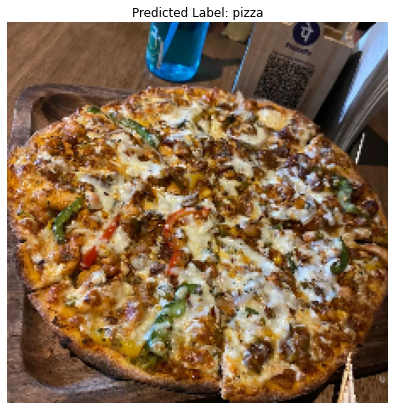

In [ ]:
preprocess_and_plot_prediction("/content/WhatsApp Image 2022-09-14 at 12.55.00.jpeg",model=model_1,class_names=class_names)

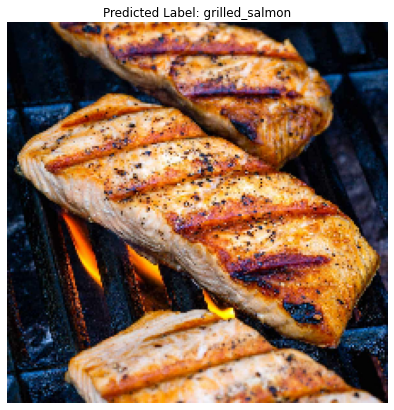

In [ ]:
preprocess_and_plot_prediction("/content/grilled-salmon-4-1200.jpg",model=model_1,class_names=class_names)

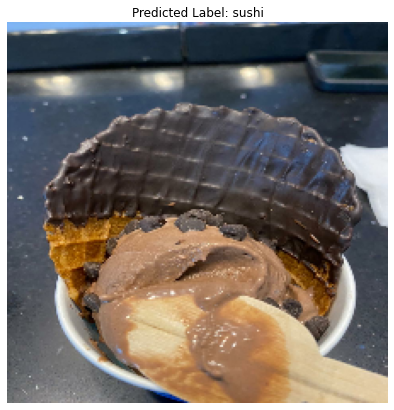

In [ ]:
preprocess_and_plot_prediction("/content/WhatsApp Image 2022-09-17 at 19.12.55.jpeg",model=model_1,class_names=class_names)

## Transfer Learning: Fine Tuning

We learnt transfer learning feature extraction previously, now its time to learn about fine tuning

In [ ]:
!wget https://raw.githubusercontent.com/ImSouritra/Deep-Learning-and-Neural-Networks/master/helper_functions.py

--2022-10-08 05:05:04--  https://raw.githubusercontent.com/ImSouritra/Deep-Learning-and-Neural-Networks/master/helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5951 (5.8K) [text/plain]
Saving to: ‘helper_functions.py’

helper_functions.py 100%[===================>]   5.81K  --.-KB/s    in 0s      

2022-10-08 05:05:04 (76.2 MB/s) - ‘helper_functions.py’ saved [5951/5951]



In [ ]:
from helper_functions import *

In [ ]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip

--2022-10-08 05:05:07--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.250.136.128, 142.250.148.128, 209.85.200.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.250.136.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 168546183 (161M) [application/zip]
Saving to: ‘10_food_classes_10_percent.zip’

10_food_classes_10_ 100%[===================>] 160.74M   109MB/s    in 1.5s    

2022-10-08 05:05:08 (109 MB/s) - ‘10_food_classes_10_percent.zip’ saved [168546183/168546183]



In [ ]:
unzip("/content/10_food_classes_10_percent.zip")

Unzipping zipfile for ya!!


In [ ]:
for dir_path, dir_name , filename in os.walk("/content/10_food_classes_10_percent"):
  print(f"There are {len(dir_path)} directories and {len(filename)} images in {dir_path}")

There are 35 directories and 0 images in /content/10_food_classes_10_percent
There are 40 directories and 0 images in /content/10_food_classes_10_percent/test
There are 54 directories and 250 images in /content/10_food_classes_10_percent/test/chicken_wings
There are 46 directories and 250 images in /content/10_food_classes_10_percent/test/steak
There are 50 directories and 250 images in /content/10_food_classes_10_percent/test/hamburger
There are 51 directories and 250 images in /content/10_food_classes_10_percent/test/fried_rice
There are 50 directories and 250 images in /content/10_food_classes_10_percent/test/ice_cream
There are 54 directories and 250 images in /content/10_food_classes_10_percent/test/chicken_curry
There are 46 directories and 250 images in /content/10_food_classes_10_percent/test/ramen
There are 46 directories and 250 images in /content/10_food_classes_10_percent/test/sushi
There are 55 directories and 250 images in /content/10_food_classes_10_percent/test/grilled_

In [ ]:
from tensorflow.keras.utils import image_dataset_from_directory


train_dir_10_percent = "/content/10_food_classes_10_percent/train"
test_dir = "/content/10_food_classes_10_percent/test"




train_data_10_percent = image_dataset_from_directory(train_dir_10_percent,
                                          image_size=(224,224),
                                          batch_size=32,
                                          label_mode="categorical",
                                          seed=42,
                                          shuffle=True)
test_data = image_dataset_from_directory(test_dir,
                                         image_size=(224,224),
                                         batch_size=32,
                                         label_mode="categorical",
                                         seed=42,
                                         shuffle=True)


Found 750 files belonging to 10 classes.
Found 2500 files belonging to 10 classes.


In [ ]:
train_data_10_percent.class_names

['chicken_curry',
 'chicken_wings',
 'fried_rice',
 'grilled_salmon',
 'hamburger',
 'ice_cream',
 'pizza',
 'ramen',
 'steak',
 'sushi']

In [ ]:
train_images, train_labels = next(iter(train_data_10_percent))

In [ ]:
train_images[0],train_labels[0]

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[1.10000000e+02, 6.32397957e+01, 0.00000000e+00],
         [1.18780609e+02, 7.49744949e+01, 7.37755108e+00],
         [1.06168365e+02, 6.54438782e+01, 1.02551079e+00],
         ...,
         [9.51429443e+01, 5.70000000e+01, 2.21426392e+00],
         [1.04714348e+02, 6.15000267e+01, 8.57146740e+00],
         [1.10357109e+02, 6.33571091e+01, 9.35710812e+00]],
 
        [[1.14693878e+02, 7.08877563e+01, 4.36224604e+00],
         [1.14423470e+02, 7.30051041e+01, 7.14285660e+00],
         [1.10346939e+02, 7.12346954e+01, 6.29081631e+00],
         ...,
         [9.44694366e+01, 5.59285736e+01, 1.34179497e+00],
         [1.00285751e+02, 5.70714264e+01, 4.14286995e+00],
         [1.07311264e+02, 5.74490089e+01, 4.40309334e+00]],
 
        [[1.07239792e+02, 6.82346954e+01, 7.65306503e-02],
         [1.13382652e+02, 7.48112259e+01, 7.59694052e+00],
         [1.13469383e+02, 7.48520432e+01, 9.94387722e+00],
         ...,
         [9

## Building a feature extraction model with keras functional api

In [ ]:
# Create base model with tf.keras.applications
base_model = tf.keras.applications.efficientnet_v2.EfficientNetV2B0(include_top=False)

24289280/24274472 [==============================] - 0s 0us/step


In [ ]:
# Freeze the base model (so the pre trained patterns remains)
base_model.trainable = False

In [ ]:
# create inputs into the base model
inputs = tf.keras.layers.Input(shape=(224,224,3),name="input_layer")

In [ ]:
# Pass the inputs to the base mode
x = base_model(inputs)

In [ ]:
#check data shape after passing it to the base model 
print(f"Shape afer passing input to base model {x.shape}")

Shape afer passing input to base model (None, 7, 7, 1280)


In [ ]:
# Average pool the output of the base model (aggregate all the most important features)
x = tf.keras.layers.GlobalAveragePooling2D(name="global_average_max_pooling_layer")(x)
print(f"Shape afer global average pooling the outputs of the base model: {x.shape}")

Shape afer global average pooling the outputs of the base model: (None, 1280)


In [ ]:
outputs = tf.keras.layers.Dense(10,name="output_layer",activation="softmax")(x)


In [ ]:
model_0 = tf.keras.Model(inputs,outputs)

In [ ]:
model_0.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(),metrics=["accuracy"])

In [ ]:
history_0  = model_0.fit(train_data_10_percent,epochs=10,steps_per_epoch=len(train_data_10_percent),validation_data=test_data,validation_steps=len(test_data),callbacks=[create_tensorboard_callback("logs","model_0_baseline")])

Creating tensorboard log file in logs/model_0_baseline2022$m$d-050518
Epoch 1/10
24/24 [==============================] - 31s 399ms/step - loss: 1.8688 - accuracy: 0.4173 - val_loss: 1.2986 - val_accuracy: 0.7360
Epoch 2/10
24/24 [==============================] - 8s 308ms/step - loss: 1.0951 - accuracy: 0.7680 - val_loss: 0.8720 - val_accuracy: 0.8200
Epoch 3/10
24/24 [==============================] - 7s 306ms/step - loss: 0.7841 - accuracy: 0.8360 - val_loss: 0.6980 - val_accuracy: 0.8436
Epoch 4/10
24/24 [==============================] - 12s 515ms/step - loss: 0.6285 - accuracy: 0.8693 - val_loss: 0.6111 - val_accuracy: 0.8544
Epoch 5/10
24/24 [==============================] - 8s 307ms/step - loss: 0.5347 - accuracy: 0.8960 - val_loss: 0.5555 - val_accuracy: 0.8632
Epoch 6/10
24/24 [==============================] - 8s 309ms/step - loss: 0.4662 - accuracy: 0.9133 - val_loss: 0.5186 - val_accuracy: 0.8644
Epoch 7/10
24/24 [==============================] - 8s 341ms/step - loss: 0.

In [ ]:
model_0.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, None, None, 1280)  5919312  
 al)                                                             
                                                                 
 global_average_max_pooling_  (None, 1280)             0         
 layer (GlobalAveragePooling                                     
 2D)                                                             
                                                                 
 output_layer (Dense)        (None, 10)                12810     
                                                                 
Total params: 5,932,122
Trainable params: 12,810
Non-trainable params: 5,919,312
______________________________________________

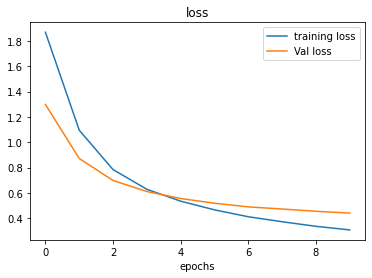

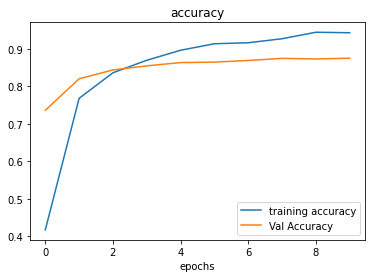

In [ ]:
plot_loss_curves(history_0)

Let's try to run some modelling experiments:
1. `Model_1`: build this model with 1 percent of data and data augmentation
2. `Model_2`: build this model with 10 percent of data and data augmentation
3. `Model_3`: Same as model_2 but we will set the include top to True to include the top layer

## Building Model_1 with 1 percent of data

In [ ]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_1_percent.zip

--2022-10-08 05:07:28--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_1_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.202.128, 74.125.69.128, 64.233.182.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.202.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 133612354 (127M) [application/zip]
Saving to: ‘10_food_classes_1_percent.zip’

10_food_classes_1_p 100%[===================>] 127.42M   146MB/s    in 0.9s    

2022-10-08 05:07:29 (146 MB/s) - ‘10_food_classes_1_percent.zip’ saved [133612354/133612354]



In [ ]:
unzip("10_food_classes_1_percent.zip")

Unzipping zipfile for ya!!


In [ ]:
for dir_path, dir_name, filename in os.walk("10_food_classes_1_percent"):
  print(f"There are {len(dir_name)} directories and {len(filename)} images in {dir_path}")

There are 2 directories and 0 images in 10_food_classes_1_percent
There are 10 directories and 0 images in 10_food_classes_1_percent/test
There are 0 directories and 250 images in 10_food_classes_1_percent/test/chicken_wings
There are 0 directories and 250 images in 10_food_classes_1_percent/test/steak
There are 0 directories and 250 images in 10_food_classes_1_percent/test/hamburger
There are 0 directories and 250 images in 10_food_classes_1_percent/test/fried_rice
There are 0 directories and 250 images in 10_food_classes_1_percent/test/ice_cream
There are 0 directories and 250 images in 10_food_classes_1_percent/test/chicken_curry
There are 0 directories and 250 images in 10_food_classes_1_percent/test/ramen
There are 0 directories and 250 images in 10_food_classes_1_percent/test/sushi
There are 0 directories and 250 images in 10_food_classes_1_percent/test/grilled_salmon
There are 0 directories and 250 images in 10_food_classes_1_percent/test/pizza
There are 10 directories and 0 ima

In [ ]:
train_1_percent_dir = "/content/10_food_classes_1_percent/train"

train_data_1_percent = image_dataset_from_directory(train_1_percent_dir,
                                                     label_mode="categorical",
                                                     batch_size=32,
                                                     seed=42,
                                                     shuffle=True,
                                                     image_size=(224,224))

Found 70 files belonging to 10 classes.


## Creating data augmentation layer with keras Sequential API

In [ ]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomZoom(0.3),
    tf.keras.layers.RandomHeight(0.2),
    tf.keras.layers.RandomWidth(0.2)
],name="data_augmentation_layer")

In [ ]:
base_model = tf.keras.applications.efficientnet_v2.EfficientNetV2B0(include_top=False)
base_model.trainable=False

inputs = tf.keras.layers.Input(shape=(224,224,3),name="input_layer")
x = data_augmentation(inputs)
x = base_model(x,training=False)
x = tf.keras.layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)
outputs = tf.keras.layers.Dense(10,activation="softmax",name="softmax")(x)
model_1 = tf.keras.Model(inputs,outputs)
model_1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(),metrics=["accuracy"])
history_1  = model_1.fit(train_data_1_percent,epochs=10,steps_per_epoch=len(train_data_1_percent),validation_data=test_data,validation_steps=len(test_data),callbacks=[create_tensorboard_callback("logs","model_1")])

Creating tensorboard log file in logs/model_12022$m$d-050737
Epoch 1/10
3/3 [==============================] - 16s 4s/step - loss: 2.3530 - accuracy: 0.1000 - val_loss: 2.2030 - val_accuracy: 0.1708
Epoch 2/10
3/3 [==============================] - 7s 3s/step - loss: 2.0982 - accuracy: 0.3429 - val_loss: 2.0846 - val_accuracy: 0.2604
Epoch 3/10
3/3 [==============================] - 7s 3s/step - loss: 1.9046 - accuracy: 0.4714 - val_loss: 1.9777 - val_accuracy: 0.3500
Epoch 4/10
3/3 [==============================] - 7s 3s/step - loss: 1.7646 - accuracy: 0.6429 - val_loss: 1.8809 - val_accuracy: 0.4116
Epoch 5/10
3/3 [==============================] - 7s 3s/step - loss: 1.6404 - accuracy: 0.7000 - val_loss: 1.7910 - val_accuracy: 0.4584
Epoch 6/10
3/3 [==============================] - 7s 3s/step - loss: 1.4759 - accuracy: 0.7429 - val_loss: 1.7046 - val_accuracy: 0.5076
Epoch 7/10
3/3 [==============================] - 7s 3s/step - loss: 1.3563 - accuracy: 0.8000 - val_loss: 1.6250 - 

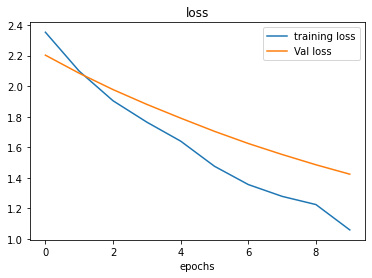

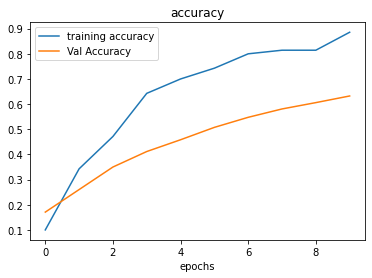

In [ ]:
plot_loss_curves(history_1)

## Building model_2

In [ ]:
base_model = tf.keras.applications.efficientnet_v2.EfficientNetV2B0(include_top=False)
base_model.trainable=False
inputs = tf.keras.layers.Input(shape=(224,224,3),name="input_layer")
x = data_augmentation(inputs)
x = base_model(x)
x = tf.keras.layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)
outputs = tf.keras.layers.Dense(10,name="output_layer",activation="softmax")(x)
model_2 = tf.keras.Model(inputs,outputs)
model_2.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(),metrics=["accuracy"])
history_2  = model_2.fit(train_data_10_percent,epochs=10,steps_per_epoch=len(train_data_10_percent),validation_data=test_data,validation_steps=len(test_data),callbacks=[create_tensorboard_callback("logs","model_2")])

Creating tensorboard log file in logs/model_22022$m$d-050916
Epoch 1/10
24/24 [==============================] - 22s 664ms/step - loss: 1.9320 - accuracy: 0.3800 - val_loss: 1.3914 - val_accuracy: 0.6808
Epoch 2/10
24/24 [==============================] - 14s 557ms/step - loss: 1.2960 - accuracy: 0.6880 - val_loss: 0.9727 - val_accuracy: 0.7804
Epoch 3/10
24/24 [==============================] - 15s 598ms/step - loss: 1.0169 - accuracy: 0.7373 - val_loss: 0.7793 - val_accuracy: 0.8180
Epoch 4/10
24/24 [==============================] - 13s 544ms/step - loss: 0.8537 - accuracy: 0.7907 - val_loss: 0.6840 - val_accuracy: 0.8296
Epoch 5/10
24/24 [==============================] - 13s 505ms/step - loss: 0.7590 - accuracy: 0.8133 - val_loss: 0.6145 - val_accuracy: 0.8492
Epoch 6/10
24/24 [==============================] - 14s 556ms/step - loss: 0.6666 - accuracy: 0.8387 - val_loss: 0.5713 - val_accuracy: 0.8484
Epoch 7/10
24/24 [==============================] - 12s 505ms/step - loss: 0.6068

In [ ]:
model_2.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation_layer (Se  (None, 224, 224, 3)      0         
 quential)                                                       
                                                                 
 efficientnetv2-b0 (Function  (None, None, None, 1280)  5919312  
 al)                                                             
                                                                 
 global_average_pooling_laye  (None, 1280)             0         
 r (GlobalAveragePooling2D)                                      
                                                                 
 output_layer (Dense)        (None, 10)                12810     
                                                           

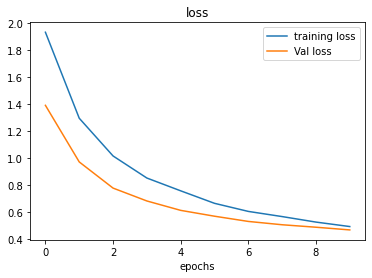

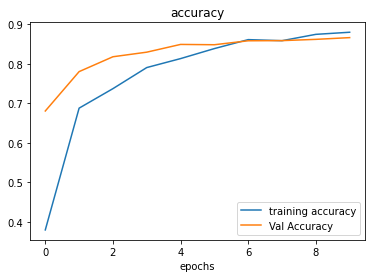

In [ ]:
plot_loss_curves(history_2)

## Creating model checkpoints

The model checkpoint callback intermediately saves our model so we can comeback and start where we left off.

In [ ]:
checkpoint_path = "ten-percent_model_checkpoints/checkpoint.ckpt"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                         save_weights_only=True,
                                                         save_best_only=False,
                                                         save_freq="epoch",
                                                         verbose=1)

In [ ]:
# Fit the model saving every epochs
initial_epochs=5
history_10_percent_data_aug = model_2.fit(train_data_10_percent,epochs=10,steps_per_epoch=len(train_data_10_percent),validation_data=test_data,validation_steps=len(test_data),callbacks=[create_tensorboard_callback("logs","model_2"),checkpoint_callback])

Creating tensorboard log file in logs/model_22022$m$d-051206
Epoch 1/10
24/24 [==============================] - ETA: 0s - loss: 0.4656 - accuracy: 0.8960
Epoch 1: saving model to ten-percent_model_checkpoints/checkpoint.ckpt
24/24 [==============================] - 13s 507ms/step - loss: 0.4656 - accuracy: 0.8960 - val_loss: 0.4630 - val_accuracy: 0.8616
Epoch 2/10
24/24 [==============================] - ETA: 0s - loss: 0.4429 - accuracy: 0.9107
Epoch 2: saving model to ten-percent_model_checkpoints/checkpoint.ckpt
24/24 [==============================] - 12s 497ms/step - loss: 0.4429 - accuracy: 0.9107 - val_loss: 0.4483 - val_accuracy: 0.8644
Epoch 3/10
24/24 [==============================] - ETA: 0s - loss: 0.4201 - accuracy: 0.8960
Epoch 3: saving model to ten-percent_model_checkpoints/checkpoint.ckpt
24/24 [==============================] - 13s 522ms/step - loss: 0.4201 - accuracy: 0.8960 - val_loss: 0.4395 - val_accuracy: 0.8652
Epoch 4/10
24/24 [==============================

In [ ]:
# What were model_0 results on test data (model_0 trained on 10% of data with no data augmentation)
model_0.evaluate(test_data)

79/79 [==============================] - 6s 71ms/step - loss: 0.4407 - accuracy: 0.8748


[0.4407042860984802, 0.8748000264167786]

In [ ]:
# What were model_2 results on test data (model_2 trained on 10% data with data augmentation)
model_2_results = model_2.evaluate(test_data)
model_2_results

79/79 [==============================] - 6s 71ms/step - loss: 0.4047 - accuracy: 0.8740


[0.40467098355293274, 0.8740000128746033]

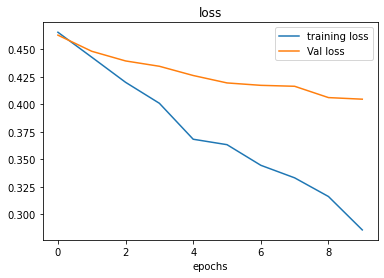

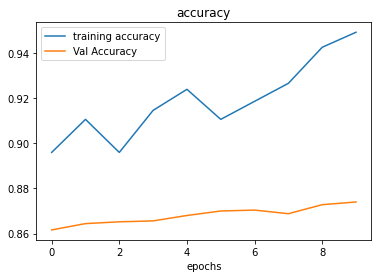

In [ ]:
plot_loss_curves(history_10_percent_data_aug)

## Loading in checkpointed weights

Loading in checkpointed weights returns a model to a specific checkpoint

In [ ]:
model_2.load_weights(checkpoint_path)

In [ ]:
loaded_weights_model_results = model_2.evaluate(test_data)

79/79 [==============================] - 6s 70ms/step - loss: 0.4047 - accuracy: 0.8740


In [ ]:
loaded_weights_model_results

[0.4046708643436432, 0.8740000128746033]

## Fine Tuning Model_2

In [ ]:
for layer in model_2.layers:
  print(layer, layer.trainable)

<keras.engine.input_layer.InputLayer object at 0x7f074fb93b90> True
<keras.engine.sequential.Sequential object at 0x7f074fd78750> True
<keras.engine.functional.Functional object at 0x7f074f65aad0> False
<keras.layers.pooling.GlobalAveragePooling2D object at 0x7f074fb89c90> True
<keras.layers.core.dense.Dense object at 0x7f074f61a290> True


In [ ]:
for i,layer in enumerate(model_2.layers[2].layers):
  print(i, layer.name, layer.trainable)

0 input_3 False
1 rescaling_2 False
2 normalization_2 False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_add False
20 block3a_expand_conv False
21 block3a_expand_bn False
22 block3a_expand_activation False
23 block3a_project_conv False
24 block3a_project_bn False
25 block3b_expand_conv False
26 block3b_expand_bn False
27 block3b_expand_activation False
28 block3b_project_conv False
29 block3b_project_bn False
30 block3b_add False
31 block4a_expand_conv False
32 block4a_expand_bn False
33 block4a_expand_activation False
34 block4a_dwconv2 False
35 block4a_bn False
36 block4a_activat

In [ ]:
# To start fine-tuning let's set the last 10 layers of our base model=True

base_model.trainable=True

## Freeze all layers except of last 10
for layer in base_model.layers[:-10]:
  layer.trainable=False

In [ ]:
model_2.compile(loss=tf.keras.losses.CategoricalCrossentropy(), optimizer=tf.keras.optimizers.Adam(0.0001), metrics=["accuracy"])

In [ ]:
for i,layer in enumerate(model_2.layers[2].layers):
  print(i,layer.name,layer.trainable) 

0 input_3 False
1 rescaling_2 False
2 normalization_2 False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_add False
20 block3a_expand_conv False
21 block3a_expand_bn False
22 block3a_expand_activation False
23 block3a_project_conv False
24 block3a_project_bn False
25 block3b_expand_conv False
26 block3b_expand_bn False
27 block3b_expand_activation False
28 block3b_project_conv False
29 block3b_project_bn False
30 block3b_add False
31 block4a_expand_conv False
32 block4a_expand_bn False
33 block4a_expand_activation False
34 block4a_dwconv2 False
35 block4a_bn False
36 block4a_activat

In [ ]:
for layer in model_2.layers:
  print(layer, layer.trainable)

<keras.engine.input_layer.InputLayer object at 0x7f074fb93b90> True
<keras.engine.sequential.Sequential object at 0x7f074fd78750> True
<keras.engine.functional.Functional object at 0x7f074f65aad0> True
<keras.layers.pooling.GlobalAveragePooling2D object at 0x7f074fb89c90> True
<keras.layers.core.dense.Dense object at 0x7f074f61a290> True


In [ ]:
print(len(model_2.trainable_variables))

12


## Fitting the fine tuned model for another 5 epochs

In [ ]:
fine_tune_epoch = initial_epochs+5

model_2.fit(train_data_10_percent,epochs=fine_tune_epoch,initial_epoch=history_10_percent_data_aug.epoch[-1],steps_per_epoch = len(train_data_10_percent),validation_data=test_data,validation_steps=len(test_data),callbacks=[create_tensorboard_callback("logs","model_2_fine_tuned")])

Creating tensorboard log file in logs/model_2_fine_tuned2022$m$d-051501
Epoch 10/10
24/24 [==============================] - ETA: 0s - loss: 0.4141 - accuracy: 0.9160
Epoch 10: saving model to ten-percent_model_checkpoints/checkpoint.ckpt
24/24 [==============================] - 22s 605ms/step - loss: 0.4141 - accuracy: 0.9160 - val_loss: 0.4301 - val_accuracy: 0.8696


In [ ]:
fine_tuned_model_results = model_2.evaluate(test_data)

79/79 [==============================] - 6s 70ms/step - loss: 0.4301 - accuracy: 0.8696


Wow, we gained about 1% accuracy on test data after we fine tuned our model, that is really amazing

Let's create a function to compare history

In [ ]:
def compare_histories(original_history,new_history,initial_epochs):
  """Compares two tensorflow history objects"""
  acc = original_history.history["accuracy"]
  loss = original_history.history["loss"]

  val_acc = original_history.history["val_accuracy"]
  val_loss = original_history.history["val_loss"]

  total_acc = acc+new_history.history["accuracy"]
  total_loss = loss = new_history.history["loss"]

  total_val_acc = val_acc+new_history.history["val_accuracy"]
  total_val_loss = val_loss = new_history.history["val_loss"]


  plt.figure(figsize=(8,8))
  plt.subplot(2,1,1)
  plt.plot(total_acc, label="Traiining Accuracy")
  plt.plot(total_val_acc, label="Val Accuracy ")
  plt.plot([initial_epochs-1,initial_epochs-1],plt.ylim(),label="Start Fine Tuning")
  plt.legend(loc="lower right")
  plt.title("Training and Validation Accuracy")


  plt.figure(figsize=(8,8))
  plt.subplot(2,1,1)
  plt.plot(total_loss, label="Traiining Loss")
  plt.plot(total_val_loss, label="Val Loss ")
  plt.plot([initial_epochs-1,initial_epochs-1],plt.ylim(),label="Start Fine Tuning")
  plt.legend(loc="lower right")
  plt.title("Training and Validation Loss")

## Fine Tuning an existing model on all data

In [ ]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_all_data.zip

--2022-10-08 05:15:30--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_all_data.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 64.233.183.128, 173.194.193.128, 173.194.194.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|64.233.183.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 519183241 (495M) [application/zip]
Saving to: ‘10_food_classes_all_data.zip’

10_food_classes_all 100%[===================>] 495.13M   213MB/s    in 2.3s    

2022-10-08 05:15:32 (213 MB/s) - ‘10_food_classes_all_data.zip’ saved [519183241/519183241]



In [ ]:
unzip("/content/10_food_classes_all_data.zip")

Unzipping zipfile for ya!!


In [ ]:
for dir_path, dir_name , filename in os.walk("/content/10_food_classes_all_data"):
  print(f"There are {len(dir_path)} directories and {len(filename)} images in {dir_path}")

There are 33 directories and 0 images in /content/10_food_classes_all_data
There are 38 directories and 0 images in /content/10_food_classes_all_data/test
There are 52 directories and 250 images in /content/10_food_classes_all_data/test/chicken_wings
There are 44 directories and 250 images in /content/10_food_classes_all_data/test/steak
There are 48 directories and 250 images in /content/10_food_classes_all_data/test/hamburger
There are 49 directories and 250 images in /content/10_food_classes_all_data/test/fried_rice
There are 48 directories and 250 images in /content/10_food_classes_all_data/test/ice_cream
There are 52 directories and 250 images in /content/10_food_classes_all_data/test/chicken_curry
There are 44 directories and 250 images in /content/10_food_classes_all_data/test/ramen
There are 44 directories and 250 images in /content/10_food_classes_all_data/test/sushi
There are 53 directories and 250 images in /content/10_food_classes_all_data/test/grilled_salmon
There are 44 di

In [ ]:
train_dir = "10_food_classes_all_data/train" 
test_dir = "10_food_classes_all_data/test"

train_data = image_dataset_from_directory(train_dir,
                                          label_mode="categorical",
                                          batch_size=32,
                                          image_size=(224,224),
                                          seed=42)

Found 7500 files belonging to 10 classes.


In [ ]:
# Evaluate  model_2(this model is fine tuned on 10 percent of data)
model_2.evaluate(test_data)

79/79 [==============================] - 6s 72ms/step - loss: 0.4301 - accuracy: 0.8696


[0.4300639033317566, 0.8695999979972839]

To train a fine-tuning model (model_3), we need to revert back model_2 back to its feature extraction weights

In [ ]:
## Load weights from checkpoint

model_2.load_weights(checkpoint_path)

In [ ]:
model_2.evaluate(test_data)

79/79 [==============================] - 9s 101ms/step - loss: 0.4301 - accuracy: 0.8696


[0.43006381392478943, 0.8695999979972839]

Alright the previous steps included:
1. Trained a feature extraction transfer learning model for 10 epochs on 10% of data with no data augmentation
2. Trained a feature extraction transfer learning model for 10 epochs on 1% of data with data augmentation
3. Trained a feature extraction transfer learning model for 10 epochs on 10% of data with data augmentation
4. fine tuned the previous model with the top 10 layers of the base model unfrozen
5. reloaded the model from step 3 to do the same steps to do the same steps except this time we're using 100% of data


In [ ]:
for i , layer in enumerate(model_2.layers[2].layers):
  print(i, layer.name, layer.trainable)

0 input_3 False
1 rescaling_2 False
2 normalization_2 False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_add False
20 block3a_expand_conv False
21 block3a_expand_bn False
22 block3a_expand_activation False
23 block3a_project_conv False
24 block3a_project_bn False
25 block3b_expand_conv False
26 block3b_expand_bn False
27 block3b_expand_activation False
28 block3b_project_conv False
29 block3b_project_bn False
30 block3b_add False
31 block4a_expand_conv False
32 block4a_expand_bn False
33 block4a_expand_activation False
34 block4a_dwconv2 False
35 block4a_bn False
36 block4a_activat

In [ ]:
model_2.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(lr=0.0001),metrics=["accuracy"])
history_4_10_classes_full = model_2.fit(train_data,epochs=initial_epochs+5,steps_per_epoch=len(train_data),validation_data=test_data,initial_epoch=history_10_percent_data_aug.epoch[-1],validation_steps=(0.25*len(test_data)),callbacks=[create_tensorboard_callback(dir_name="logs",experiment_name="full_10_classes_fine_tuned")])

Creating tensorboard log file in logs/full_10_classes_fine_tuned2022$m$d-052530
Epoch 10/10


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


235/235 [==============================] - 57s 215ms/step - loss: 0.5994 - accuracy: 0.8167 - val_loss: 0.3155 - val_accuracy: 0.8984


In [ ]:
results_fine_tune_full_data = model_2.evaluate(test_data)
results_fine_tune_full_data

79/79 [==============================] - 6s 73ms/step - loss: 0.3123 - accuracy: 0.8976


[0.3122566342353821, 0.897599995136261]

## Transfer Learning: Scaling Up
Now it's time to scale up to all the classes in Food101(101 classes of food)

Our goal is to beat the original paper of food101 with 10% of the data

In [2]:
!wget https://raw.githubusercontent.com/ImSouritra/Deep-Learning-and-Neural-Networks/master/helper_functions.py

--2022-10-13 04:35:23--  https://raw.githubusercontent.com/ImSouritra/Deep-Learning-and-Neural-Networks/master/helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7705 (7.5K) [text/plain]
Saving to: ‘helper_functions.py’

helper_functions.py 100%[===================>]   7.52K  --.-KB/s    in 0s      

2022-10-13 04:35:23 (92.9 MB/s) - ‘helper_functions.py’ saved [7705/7705]



In [3]:
from helper_functions import *

In [4]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/101_food_classes_10_percent.zip

--2022-10-13 04:35:28--  https://storage.googleapis.com/ztm_tf_course/food_vision/101_food_classes_10_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.20.128, 74.125.197.128, 74.125.142.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.20.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1625420029 (1.5G) [application/zip]
Saving to: ‘101_food_classes_10_percent.zip’

101_food_classes_10 100%[===================>]   1.51G   116MB/s    in 14s     

2022-10-13 04:35:42 (112 MB/s) - ‘101_food_classes_10_percent.zip’ saved [1625420029/1625420029]



In [5]:
unzip("/content/101_food_classes_10_percent.zip")

Unzipping zipfile for ya!!


In [6]:
for dir_path, dir_name, filename in os.walk("/content/101_food_classes_10_percent"):
  print(f" There are {len(dir_name)} directories and {len(filename)} images in {dir_path}")

 There are 2 directories and 0 images in /content/101_food_classes_10_percent
 There are 101 directories and 0 images in /content/101_food_classes_10_percent/train
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/cannoli
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/gnocchi
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/chocolate_mousse
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/tacos
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/fish_and_chips
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/mussels
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/beignets
 There are 0 directories and 75 images in /content/101_food_classes_10_percent/train/paella
 There are 0 directories and 75 images in /content/101_food_classes_10_percent

In [7]:
train_dir = "/content/101_food_classes_10_percent/train"
test_dir = "/content/101_food_classes_10_percent/test"

train_data = image_dataset_from_directory(train_dir,
                                          label_mode="categorical",
                                          image_size=(224,224),
                                          batch_size=32,
                                          seed=42,
                                          shuffle=True)

test_data = image_dataset_from_directory(test_dir,
                                        label_mode="categorical",
                                        image_size=(224,224),
                                        batch_size=32,
                                        seed=42,
                                        shuffle=False)

Found 7575 files belonging to 101 classes.
Found 25250 files belonging to 101 classes.


## Training a big model with transfer learning for 10% of 101 food classes

Here are the steps we are going to take:
* Create a model checkoint callback
* Create a data augmentation layer
* Build a headless (No top layers) backboned EfficientNetV2 model 
* Feature extract for 5 full epochs 

In [ ]:
checkpoint_path = "ten_percent_101_model_checkpoints/checkpoint.ckpt"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                         save_weights_only=True,
                                                         save_best_only=True,
                                                         save_freq="epoch",
                                                         verbose=1,
                                                         monitor="val_accuracy") 

In [ ]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomHeight(0.3),
    tf.keras.layers.RandomWidth(0.3),
    tf.keras.layers.RandomZoom(0.3)
],name="data_augmentation_layer")

In [ ]:
base_model = tf.keras.applications.efficientnet_v2.EfficientNetV2B0(include_top=False)
base_model.trainable=False

inputs = tf.keras.layers.Input(shape=(224,224,3),name="input_layer")
x = data_augmentation(inputs)
x = base_model(x)
x = tf.keras.layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)
outputs = tf.keras.layers.Dense(len(train_data.class_names),activation="softmax",name="ouput_layer")(x)
model_3 = tf.keras.Model(inputs,outputs)
model_3.summary() 

24289280/24274472 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 data_augmentation_layer (Se  (None, 224, 224, 3)      0         
 quential)                                                       
                                                                 
 efficientnetv2-b0 (Function  (None, None, None, 1280)  5919312  
 al)                                                             
                                                                 
 global_average_pooling_laye  (None, 1280)             0         
 r (GlobalAveragePooling2D)                                      
                                                                 
 ouput_layer (Dense)         (None, 101)               129381 

In [ ]:
model_3.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(),metrics=["accuracy"])
history_3 = model_3.fit(train_data,epochs=5,steps_per_epoch=len(train_data),validation_data=test_data,validation_steps=(0.25*len(test_data)),callbacks=[create_tensorboard_callback("logs","model_3_10%"),checkpoint_callback])

Creating tensorboard log file in logs/model_3_10%2022$m$d-053723
Epoch 1/5
237/237 [==============================] - ETA: 0s - loss: 3.4374 - accuracy: 0.2557
Epoch 1: val_accuracy improved from -inf to 0.37737, saving model to ten_percent_101_model_checkpoints/checkpoint.ckpt
237/237 [==============================] - 134s 504ms/step - loss: 3.4374 - accuracy: 0.2557 - val_loss: 2.6810 - val_accuracy: 0.3774
Epoch 2/5
237/237 [==============================] - ETA: 0s - loss: 2.2852 - accuracy: 0.4803
Epoch 2: val_accuracy improved from 0.37737 to 0.46528, saving model to ten_percent_101_model_checkpoints/checkpoint.ckpt
237/237 [==============================] - 90s 377ms/step - loss: 2.2852 - accuracy: 0.4803 - val_loss: 2.1878 - val_accuracy: 0.4653
Epoch 3/5
237/237 [==============================] - ETA: 0s - loss: 1.9018 - accuracy: 0.5522
Epoch 3: val_accuracy improved from 0.46528 to 0.49448, saving model to ten_percent_101_model_checkpoints/checkpoint.ckpt
237/237 [=========

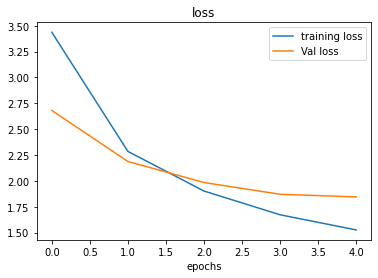

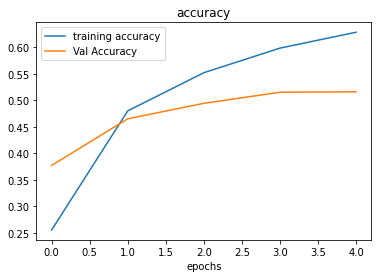

In [ ]:
plot_loss_curves(history_3)

In [ ]:
base_model.trainable=True
for layer in base_model.layers[:-5]:
  layer.trainable=False

In [ ]:
model_3.compile(loss=tf.keras.losses.CategoricalCrossentropy(),optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),metrics=["accuracy"])
history_3 = model_3.fit(train_data,epochs=10,initial_epoch=history_3.epoch[-1],steps_per_epoch=len(train_data),validation_data=test_data,validation_steps=(0.25*len(test_data)),callbacks=[create_tensorboard_callback("logs","model_3_fine_tuned")])

Creating tensorboard log file in logs/model_3_fine_tuned2022$m$d-061637
Epoch 5/10
237/237 [==============================] - 81s 298ms/step - loss: 1.5541 - accuracy: 0.6484 - val_loss: 1.8415 - val_accuracy: 0.5253
Epoch 6/10
237/237 [==============================] - 66s 278ms/step - loss: 1.4011 - accuracy: 0.6826 - val_loss: 1.7321 - val_accuracy: 0.5467
Epoch 7/10
237/237 [==============================] - 63s 266ms/step - loss: 1.3217 - accuracy: 0.6999 - val_loss: 1.6860 - val_accuracy: 0.5556
Epoch 8/10
237/237 [==============================] - 63s 263ms/step - loss: 1.2552 - accuracy: 0.7131 - val_loss: 1.6634 - val_accuracy: 0.5598
Epoch 9/10
237/237 [==============================] - 50s 211ms/step - loss: 1.2052 - accuracy: 0.7241 - val_loss: 1.6262 - val_accuracy: 0.5666
Epoch 10/10
237/237 [==============================] - 57s 238ms/step - loss: 1.1660 - accuracy: 0.7255 - val_loss: 1.6007 - val_accuracy: 0.5726


In [ ]:
model_3.save("/content/drive/MyDrive/model_3_food_vision_fine_tuned.h5")

In [10]:
loaded_model = tf.keras.models.load_model("/content/drive/MyDrive/model_3_food_vision_fine_tuned.h5")

In [11]:
loaded_model.evaluate(test_data)

790/790 [==============================] - 71s 78ms/step - loss: 1.3943 - accuracy: 0.6256


[1.394327998161316, 0.6256237626075745]

## Evaluating model results

In [12]:
# Make predictions with model
pred_probs = loaded_model.predict(test_data)
pred_probs

790/790 [==============================] - 61s 76ms/step


array([[2.6280235e-03, 3.1059835e-04, 8.8222519e-02, ..., 3.3195909e-05,
        4.2018830e-03, 4.0107133e-04],
       [4.6480179e-01, 1.0694324e-05, 9.8426435e-03, ..., 2.5887648e-03,
        7.8130361e-05, 4.1751034e-04],
       [2.8290871e-01, 4.3266700e-04, 8.4683485e-03, ..., 2.2909637e-03,
        6.2085805e-04, 2.2538255e-03],
       ...,
       [4.2262540e-04, 4.7417827e-02, 7.9022539e-05, ..., 1.0463560e-03,
        3.3824254e-02, 1.2406119e-02],
       [5.1889811e-03, 5.4416680e-03, 4.3256497e-03, ..., 5.3227334e-03,
        1.3034468e-03, 3.2324925e-01],
       [1.4940791e-02, 2.5747651e-02, 5.9731123e-03, ..., 7.4527604e-03,
        1.4851438e-03, 1.6791676e-01]], dtype=float32)

In [13]:
len(pred_probs)

25250

In [36]:
pred_classes = pred_probs.argmax(axis=1)
pred_class_array = [train_data.class_names[i]for i in pred_classes]
pred_class_df = pd.DataFrame({"pred_class":pred_classes,"class_name":pred_class_array})
pred_class_df

,pred_class,class_name
0,85,samosa
1,0,apple_pie
2,0,apple_pie
3,0,apple_pie
4,8,bread_pudding
...,...,...
25245,100,waffles
25246,100,waffles
25247,56,huevos_rancheros
25248,100,waffles


In [39]:
pred_class_df.value_counts()

pred_class  class_name          
9           breakfast_burrito       435
37          filet_mignon            424
26          crab_cakes              415
80          pulled_pork_sandwich    349
38          fish_and_chips          340
                                   ... 
82          ravioli                 154
71          paella                  143
0           apple_pie               135
50          grilled_salmon          129
39          foie_gras               112
Length: 101, dtype: int64

In [15]:
y_labels = []
for images,labels in test_data.unbatch():
  y_labels.append(labels.numpy().argmax())

In [16]:
y_labels[:10]

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

## Evaluating model predictions

In [17]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, confusion_matrix

In [18]:
accuracy_score = accuracy_score(y_labels, pred_classes)
accuracy_score

0.6256237623762376

In [19]:
precision_score = precision_score(y_labels, pred_classes,average="micro")
precision_score

0.6256237623762376

In [ ]:
import itertools
def make_confusion_matrix(y_true, y_pred, classes=None, figsize=(10, 10), text_size=15, norm=False, savefig=False): 
  """Makes a labelled confusion matrix comparing predictions and ground truth labels.
  If classes is passed, confusion matrix will be labelled, if not, integer class values
  will be used.
  Args:
    y_true: Array of truth labels (must be same shape as y_pred).
    y_pred: Array of predicted labels (must be same shape as y_true).
    classes: Array of class labels (e.g. string form). If `None`, integer labels are used.
    figsize: Size of output figure (default=(10, 10)).
    text_size: Size of output figure text (default=15).
    norm: normalize values or not (default=False).
    savefig: save confusion matrix to file (default=False).
  
  Returns:
    A labelled confusion matrix plot comparing y_true and y_pred.
  Example usage:
    make_confusion_matrix(y_true=test_labels, # ground truth test labels
                          y_pred=y_preds, # predicted labels
                          classes=class_names, # array of class label names
                          figsize=(15, 15),
                          text_size=10)
  """  
  # Create the confustion matrix
  cm = confusion_matrix(y_true, y_pred)
  cm_norm = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis] # normalize it
  n_classes = cm.shape[0] # find the number of classes we're dealing with

  # Plot the figure and make it pretty
  fig, ax = plt.subplots(figsize=figsize)
  cax = ax.matshow(cm, cmap=plt.cm.Blues) # colors will represent how 'correct' a class is, darker == better
  fig.colorbar(cax)

  # Are there a list of classes?
  if classes:
    labels = classes
  else:
    labels = np.arange(cm.shape[0])
  
  # Label the axes
  ax.set(title="Confusion Matrix",
         xlabel="Predicted label",
         ylabel="True label",
         xticks=np.arange(n_classes), # create enough axis slots for each class
         yticks=np.arange(n_classes), 
         xticklabels=labels, # axes will labeled with class names (if they exist) or ints
         yticklabels=labels)
  
  # Make x-axis labels appear on bottom
  ax.xaxis.set_label_position("bottom")
  ax.xaxis.tick_bottom()

  # Change plot x_label vertical
  plt.xticks(rotation=70,fontsize=text_size)
  plt.yticks(fontsize=text_size) 

  # Set the threshold for different colors
  threshold = (cm.max() + cm.min()) / 2.

  # Plot the text on each cell
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    if norm:
      plt.text(j, i, f"{cm[i, j]} ({cm_norm[i, j]*100:.1f}%)",
              horizontalalignment="center",
              color="white" if cm[i, j] > threshold else "black",
              size=text_size)
    else:
      plt.text(j, i, f"{cm[i, j]}",
              horizontalalignment="center",
              color="white" if cm[i, j] > threshold else "black",
              size=text_size)

  # Save the figure to the current working directory
  if savefig:
    fig.savefig("confusion_matrix.png")

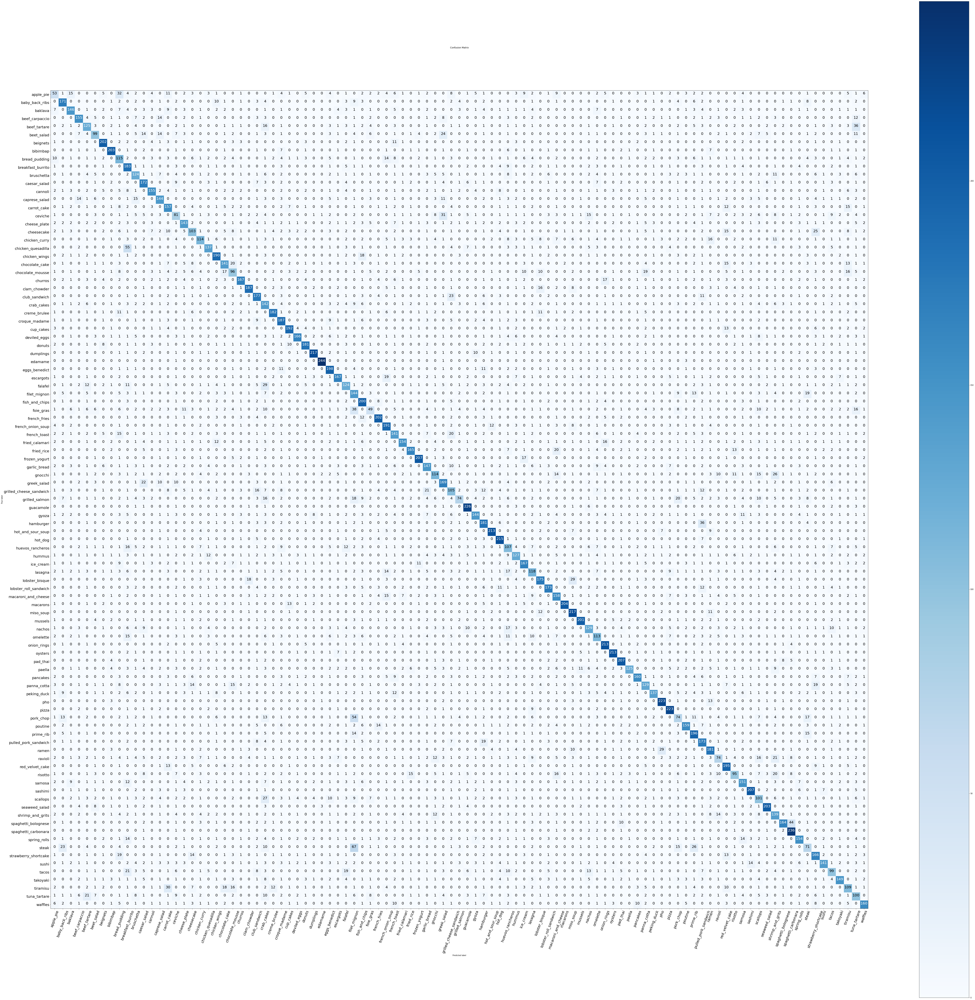

In [ ]:
conf_mx = confusion_matrix(y_labels, pred_classes)
make_confusion_matrix(y_labels,pred_classes,classes=train_data.class_names,figsize=(100,100),text_size=20)

In [20]:
from sklearn.metrics import classification_report

In [21]:
classification_report(y_labels,pred_classes)

'              precision    recall  f1-score   support\n\n           0       0.39      0.21      0.28       250\n           1       0.65      0.68      0.66       250\n           2       0.66      0.58      0.62       250\n           3       0.70      0.62      0.66       250\n           4       0.52      0.50      0.51       250\n           5       0.56      0.40      0.46       250\n           6       0.77      0.81      0.79       250\n           7       0.82      0.81      0.82       250\n           8       0.36      0.46      0.40       250\n           9       0.42      0.73      0.53       250\n          10       0.51      0.50      0.51       250\n          11       0.57      0.69      0.62       250\n          12       0.75      0.62      0.68       250\n          13       0.59      0.58      0.58       250\n          14       0.51      0.63      0.56       250\n          15       0.38      0.32      0.35       250\n          16       0.62      0.57      0.60       250\n       

In [22]:
classification_report_dict = classification_report(y_labels,pred_classes,output_dict=True)

In [23]:
# Let's plot all our F1-scores
class_f1_scores={}

for k, v in classification_report_dict.items():
  if k=="accuracy":
    break
  else:
    class_f1_scores[test_data.class_names[int(k)]] = v["f1-score"]

In [24]:
class_f1_scores

{'apple_pie': 0.2753246753246753,
 'baby_back_ribs': 0.6640776699029126,
 'baklava': 0.6199575371549894,
 'beef_carpaccio': 0.6567796610169492,
 'beef_tartare': 0.5091649694501019,
 'beet_salad': 0.46261682242990654,
 'beignets': 0.787524366471735,
 'bibimbap': 0.8152610441767069,
 'bread_pudding': 0.4042179261862918,
 'breakfast_burrito': 0.5343065693430658,
 'bruschetta': 0.5050916496945009,
 'caesar_salad': 0.6220614828209764,
 'cannoli': 0.6798245614035088,
 'caprese_salad': 0.5841784989858011,
 'carrot_cake': 0.5617173524150268,
 'ceviche': 0.34989200863930886,
 'cheese_plate': 0.5958333333333333,
 'cheesecake': 0.4537444933920705,
 'chicken_curry': 0.5146726862302483,
 'chicken_quesadilla': 0.6021978021978022,
 'chicken_wings': 0.7063197026022305,
 'chocolate_cake': 0.5949367088607594,
 'chocolate_mousse': 0.4129032258064516,
 'churros': 0.7245119305856834,
 'clam_chowder': 0.7648261758691207,
 'club_sandwich': 0.6401446654611213,
 'crab_cakes': 0.4270676691729323,
 'creme_brulee

In [25]:
f1_scores = pd.DataFrame({"class_names":list(class_f1_scores.keys()),"f1-scores":list(class_f1_scores.values())})
f1_scores

,class_names,f1-scores
0,apple_pie,0.275325
1,baby_back_ribs,0.664078
2,baklava,0.619958
3,beef_carpaccio,0.656780
4,beef_tartare,0.509165
...,...,...
96,tacos,0.454128
97,takoyaki,0.663697
98,tiramisu,0.457023
99,tuna_tartare,0.372439


In [40]:
f1_scores = f1_scores.sort_values(by="f1-scores",ascending=False)
f1_scores.head()

,class_names,f1-scores
33,edamame,0.966337
63,macarons,0.886957
32,dumplings,0.859406
54,hot_and_sour_soup,0.858871
75,pho,0.851145


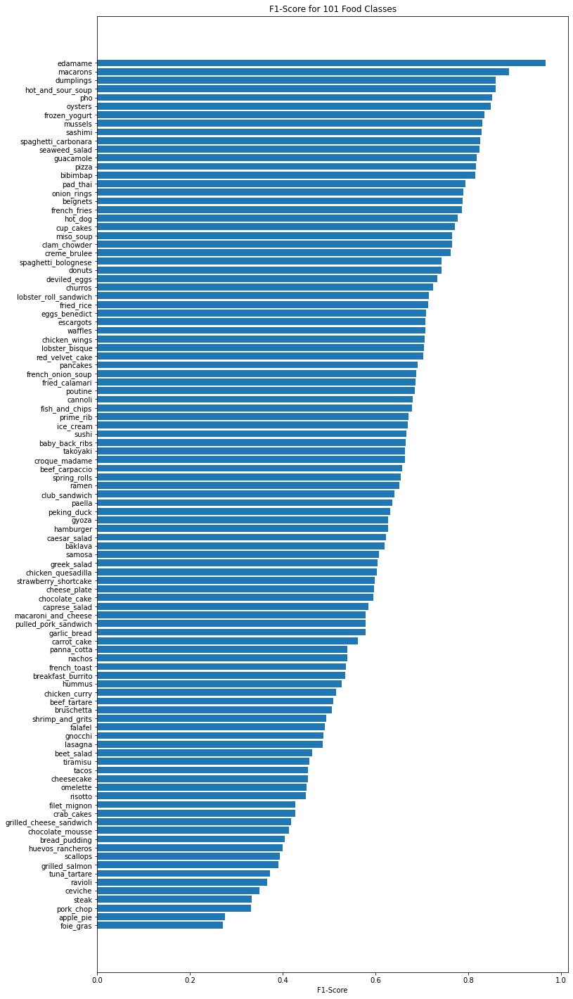

In [27]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(12,25))
scores = ax.barh(range(len(f1_scores)),f1_scores["f1-scores"].values)
ax.set_yticks(range(len(f1_scores)))
ax.set_yticklabels(f1_scores["class_names"]);
ax.set_xlabel("F1-Score")
ax.set_title("F1-Score for 101 Food Classes")
ax.invert_yaxis();

In [28]:
def load_and_prep_image(filename,img_shape=(224,224),scale=True):
  """" Preaprocess a given image return it"""
  image = tf.io.read_file(filename)
  image = tf.image.decode_image(image,channels=3)
  image = tf.image.resize(image,size=img_shape)
  if scale:
    image = image/255
    return image
  else:
    return image  

1/1 [==============================] - 0s 23ms/step


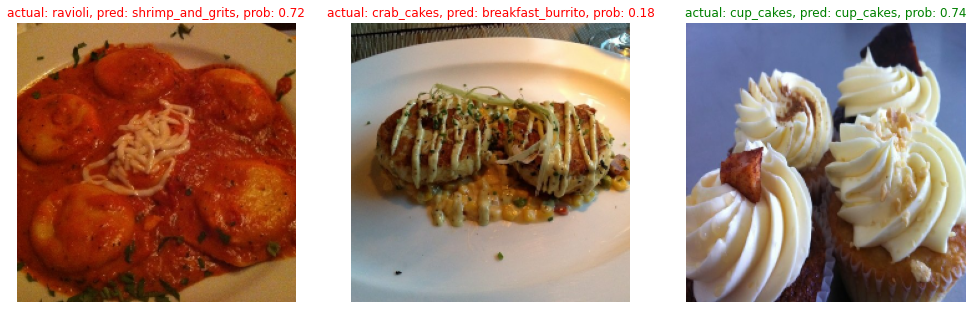

In [51]:
import os
import random

plt.figure(figsize=(17, 10))
for i in range(3):
  # Choose a random image from a random class 
  class_name = random.choice(train_data.class_names)
  filename = random.choice(os.listdir(test_dir + "/" + class_name))
  filepath = test_dir+"/" + class_name + "/" + filename

  # Load the image and make predictions
  img = load_and_prep_image(filepath, scale=False) # don't scale images for EfficientNet predictions
  pred_prob = loaded_model.predict(tf.expand_dims(img, axis=0)) # model accepts tensors of shape [None, 224, 224, 3]
  pred_class = train_data.class_names[pred_prob.argmax()] # find the predicted class 

  # Plot the image(s)
  plt.subplot(1, 3, i+1)
  plt.imshow(img/255.)
  if class_name == pred_class: # Change the color of text based on whether prediction is right or wrong
    title_color = "g"
  else:
    title_color = "r"
  plt.title(f"actual: {class_name}, pred: {pred_class}, prob: {pred_prob.max():.2f}", c=title_color)
  plt.axis(False);

In [30]:
loaded_model.evaluate(test_data)

790/790 [==============================] - 56s 71ms/step - loss: 1.3943 - accuracy: 0.6256


[1.394327998161316, 0.6256237626075745]

We'll go through the following steps:

* Get all of the image file paths in the test dataset using the list_files() method.
* Create a pandas DataFrame of the image filepaths, ground truth labels, prediction classes, max prediction probabilities, ground truth class names and predicted class names.
`Note: We don't necessarily have to create a DataFrame like this but it'll help us visualize things as we go.`
* Use our DataFrame to find all the wrong predictions (where the ground truth doesn't match the prediction).
* Sort the DataFrame based on wrong predictions and highest max prediction probabilities.
* Visualize the images with the highest prediction probabilities but have the wrong prediction.

In [54]:
filepaths = []

for filepath in test_data.list_files("101_food_classes_10_percent/test/*/*.jpg",shuffle=False):
  filepaths.append(filepath.numpy())
filepaths[:10]

[b'101_food_classes_10_percent/test/apple_pie/1011328.jpg',
 b'101_food_classes_10_percent/test/apple_pie/101251.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1034399.jpg',
 b'101_food_classes_10_percent/test/apple_pie/103801.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1038694.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1047447.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1068632.jpg',
 b'101_food_classes_10_percent/test/apple_pie/110043.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1106961.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1113017.jpg']

In [55]:
pred_df = pd.DataFrame({"img_path":filepaths,"y_true":y_labels,"y_pred":pred_classes,"actual_classname":[train_data.class_names[i] for i in y_labels],"predicted_class_name":pred_class_array})
pred_df.head()

,img_path,y_true,y_pred,actual_classname,predicted_class_name
0,b'101_food_classes_10_percent/test/apple_pie/1...,0,85,apple_pie,samosa
1,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,apple_pie,apple_pie
2,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,apple_pie,apple_pie
3,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,apple_pie,apple_pie
4,b'101_food_classes_10_percent/test/apple_pie/1...,0,8,apple_pie,bread_pudding


In [56]:
pred_df["pred_correct"] = pred_df["y_true"] == pred_df["y_pred"]
pred_df["pred_correct"]

0        False
1         True
2         True
3         True
4        False
         ...  
25245     True
25246     True
25247    False
25248     True
25249     True
Name: pred_correct, Length: 25250, dtype: bool

In [57]:
pred_df["pred_correct"].value_counts()

True     15797
False     9453
Name: pred_correct, dtype: int64

In [58]:
pred_df["pred_conf"] = pred_probs.max(axis=1)

In [59]:
top_100_wrong = pred_df[pred_df["pred_correct"] == False].sort_values("pred_conf", ascending=False)[:100]
top_100_wrong.head(20)

,img_path,y_true,y_pred,actual_classname,predicted_class_name,pred_correct,pred_conf
9690,b'101_food_classes_10_percent/test/fish_and_ch...,38,20,fish_and_chips,chicken_wings,False,0.990488
18001,b'101_food_classes_10_percent/test/pancakes/10...,72,67,pancakes,omelette,False,0.990068
23797,b'101_food_classes_10_percent/test/sushi/16593...,95,86,sushi,sashimi,False,0.989283
4836,b'101_food_classes_10_percent/test/chicken_que...,19,9,chicken_quesadilla,breakfast_burrito,False,0.984576
8982,b'101_food_classes_10_percent/test/escargots/7...,35,31,escargots,donuts,False,0.982630
14482,b'101_food_classes_10_percent/test/hummus/8476...,57,51,hummus,guacamole,False,0.980820
5114,b'101_food_classes_10_percent/test/chicken_win...,20,38,chicken_wings,fish_and_chips,False,0.979132
10880,b'101_food_classes_10_percent/test/fried_calam...,43,68,fried_calamari,onion_rings,False,0.978896
14062,b'101_food_classes_10_percent/test/huevos_ranc...,56,28,huevos_rancheros,croque_madame,False,0.977624
403,b'101_food_classes_10_percent/test/baby_back_r...,1,20,baby_back_ribs,chicken_wings,False,0.974730


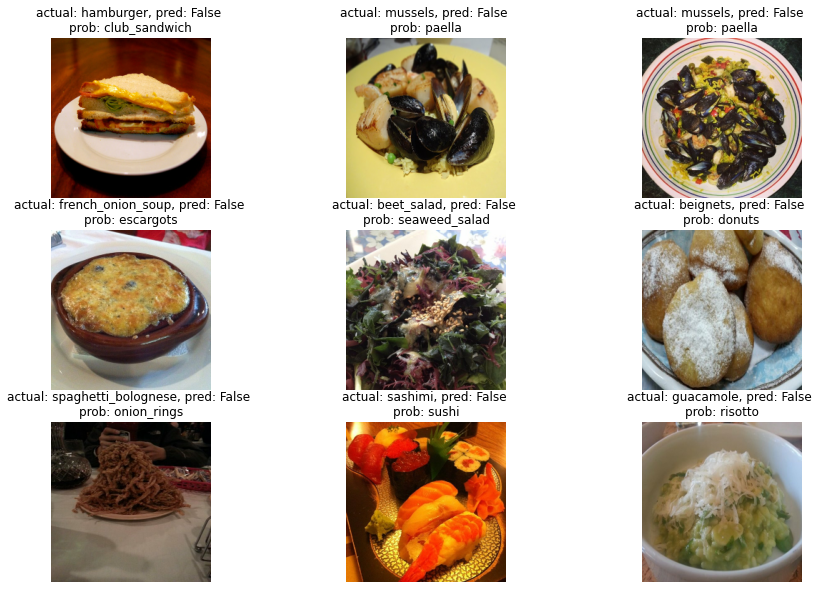

In [70]:
#Visualize some of the most wrong examples
images_to_view = 9
start_index = 10 # change the start index to view more
plt.figure(figsize=(15, 10))
for i, row in enumerate(top_100_wrong[start_index:start_index+images_to_view].itertuples()): 
  plt.subplot(3, 3, i+1)
  img = load_and_prep_image(row[1], scale=True)
  _, _, _, _, pred_conf, y_true, y_pred, _ = row # only interested in a few parameters of each row
  plt.imshow(img)
  plt.title(f"actual: {y_true}, pred: {y_pred} \nprob: {pred_conf}")
  plt.axis(False)